---

<h1>P5 EXPLORATORY DATA ANALYSIS<span class="tocSkip"></span></h1>
Lérys Granado - 08/2021

---

# Notes

## Objectives:

- **This is a clustering issue**.


- **Objectives of OC project**: 

   - Olist souhaite que vous fournissiez à ses équipes d'e-commerce une **segmentation des clients** qu’elles pourront **utiliser au quotidien** pour leurs campagnes de communication.

   - Votre objectif est de **comprendre les différents types d’utilisateurs** grâce à leur **comportement** et à leurs **données personnelles**.

   - Vous devrez fournir à l’équipe marketing une **description actionable** de votre segmentation et de sa **logique sous-jacente pour une utilisation optimale**, ainsi qu’une **proposition de contrat de maintenance** basée sur une analyse de la stabilité des segments au cours du temps.
 
 
- **Objectives of this notebook**:

    - Understand the dataset
    - Data cleaning
    - Develop a ML strategy
 

## Form of datasets & merging

- **Form of data : 9 csv files** 


- **Datasets have different shapes**:<br>
        - olist_customers_dataset---------------(99441, 5) 
        - olist_geolocation_dataset-------------(1000163, 5)
        - olist_orders_dataset------------------(99441, 8)
        - olist_order_items_dataset-------------(112650, 7)
        - olist_order_payments_dataset----------(103886, 5)
        - olist_order_reviews_dataset-----------(100000, 7)
        - olist_products_dataset----------------(32951, 9)
        - olist_sellers_dataset-----------------(3095, 4)
        - product_category_name_translation-----(71, 2)


- **Missing value only on 3 datasets**: 
    - olist_order_reviews_dataset : 21%
    - olist_orders_dataset : 1%
    - olist_products_dataset : 1%
    
- **Instruction to merge datasets**
<div>
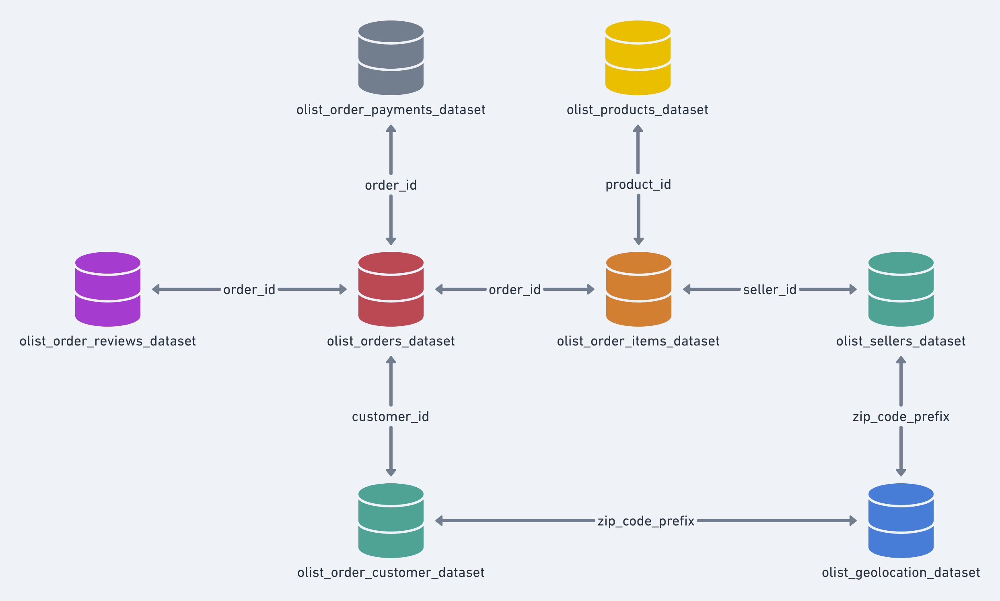
</div>


## Form analysis of merged data

- **Shape**: 119151 rows, 44 columns<br><br>

- **Duplicates**: 0%<br><br>

- **Missing values**:
    - Total missing values: 4%
    - "review_comment_title": 2%
    - "review_comment_message": 1%<br><br>
    
- **Data type counts**:
    - object: 24 (55%)
    - float64: 16 (41%)
    - int64: 2 (5%)<br><br>
    
- **A priori not interesting variables**
   - customer_id
   - customer_unique_id 
   - order_id 
   - product_id 
   - seller_id  
   - product_category_name   
   - review_comment_title    
   - review_comment_message <br><br><br> 
    
- **A priori interesting variables**
    - customer_unique_id: is an id that is permanent & unique for one give customer
    - customer_id: is an id that change from order to order
    - product_category_name_english<br><br>
    
    - payment_installments, e.g.: 
        - 1.0     59447
        - 2.0     13840
        - 3.0     11889
        - 4.0      8073
        - etc <br><br>
    
    - price
       - mean:        120
       - std:        184
       - min:          0
       - 25%:         39
       - 50%:         74
       - 75%:        134
       - max:       6735<br><br>
       
    - order_item_id: 
        - number of items on the same order (integers from 1 to 21)<br><br>
    
    - payment_type:
       - credit_card: 74%
       - boleto (= note(EN), billets (FR)): 19%
       - voucher: 5%   
       - debit_card: 1%
       - not_defined: ~0%<br><br>
       
    - review_score:
         -   mean:         4.0
         -   std:          1.4
         -   min:          1.0
         -   25%:          3.0
         -   50%:          5.0
         -   75%:          5.0
         -   max:          5.0

# Setting environment

In [4]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999

<IPython.core.display.Javascript object>

In [4]:
import os
import numpy as np
import scipy.stats as stats
import pandas as pd
from IPython.core.interactiveshell import InteractiveShell
# Allow Jupyter print all instance lines #
InteractiveShell.ast_node_interactivity = "last_expr"  # choose all or last_expr

In [1]:
import seaborn as sns
import matplotlib
from matplotlib import rc
import matplotlib.pyplot as plt
%matplotlib inline
rc = {"font.size": 16, "font.family": "Arial", "axes.labelsize": 16,
      "legend.fontsize": 14, "axes.titlesize": 16,
      "xtick.labelsize": 14, "ytick.labelsize": 14}
sns.set(font="Arial", rc=rc, palette="viridis" )
sns.set_style("ticks", {"axes.edgecolor": "k", "axes.linewidth": 0.8, "axes.grid": False,
                        "xtick.major.width": 0.8, "ytick.major.width": 0.8})

# Data import

- Raw data in csv file can be downloaded at "https://www.kaggle.com/olistbr/brazilian-ecommerce"
- Import data in a dictionnary and create DataFrames from the latter

In [5]:
import os
PATH = os.getcwd()

data_PATH = PATH + "\data.csv"
df_cleaned_PATH = PATH + "\data_cleaned.csv"
df_PATH = PATH + "\df_gped.csv"
X_tsne_PATH = PATH + "\X_tsne.csv"
df_label_PATH = PATH + "\df_label.csv"
df2_PATH = PATH + "\df2.csv"

In [8]:
df3 = pd.read_csv(df_cleaned_PATH)

In [802]:
data = pd.read_csv(data_PATH, encoding="utf-8")
data.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,...,review_comment_message,review_creation_date,review_answer_timestamp,seller_zip_code_prefix,seller_city,seller_state,geolocation_lat,geolocation_lng,geolocation_lat_customer,geolocation_lng_customer
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,...,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,8577.0,itaquaquecetuba,SP,-23.486111,-46.366721,-20.498489,-47.396929
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,...,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,88303.0,itajai,SC,-26.912574,-48.673980,-23.727992,-46.542848
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,...,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,8577.0,itaquaquecetuba,SP,-23.486111,-46.366721,-23.531642,-46.656289
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,...,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,8577.0,itaquaquecetuba,SP,-23.486111,-46.366721,-23.499702,-46.185233
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,...,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,14940.0,ibitinga,SP,-21.757321,-48.829744,-22.975100,-47.142925


In [6]:
import_dict = {}
for f in os.listdir(PATH):
    if f.endswith(".csv"):
        import_dict[f.replace('olist_', '')
                    .replace('dataset', 'df').replace('.csv', '')
                    ] = pd.read_csv(f, sep=",")

# DataFrames are named after their filenames from dict. keys

for key, val in import_dict.items():
    exec(key + "=val")

ParserError: Error tokenizing data. C error: Expected 1 fields in line 4, saw 2


# Dataset form

## First sight

- Let's get a first grasp on the data

In [170]:
df_summary = pd.DataFrame({})

for key, val in import_dict.items():
    df_summary.loc[key, "N_row"] = len(val.index)
    df_summary.loc[key, "N_col"] = len(val.columns)
    df_summary.loc[key, "Duplicates rate"] = (len(val)
                                              - len(val.drop_duplicates())
                                              )/len(val)
    df_summary.loc[key, "NaN rate"] = val.isna().sum().sum()/val.size
    df_summary.loc[key, "col_1"] = val.columns[0]
    df_summary.loc[key, "col_2"] = val.columns[1]
    if len(val.columns) > 2:
        df_summary.loc[key, "col_3"] = val.columns[2]

df_summary

,N_row,N_col,Duplicates rate,NaN rate,col_1,col_2,col_3
customers_df,99441.0,5.0,0.000000,0.000000,customer_id,customer_unique_id,customer_zip_code_prefix
geolocation_df,1000163.0,5.0,0.261788,0.000000,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
orders_df,99441.0,8.0,0.000000,0.006169,order_id,customer_id,order_status
order_items_df,112650.0,7.0,0.000000,0.000000,order_id,order_item_id,product_id
order_payments_df,103886.0,5.0,0.000000,0.000000,order_id,payment_sequential,payment_type
order_reviews_df,100000.0,7.0,0.000000,0.209331,review_id,order_id,review_score
products_df,32951.0,9.0,0.000000,0.008255,product_id,product_category_name,product_name_lenght
sellers_df,3095.0,4.0,0.000000,0.000000,seller_id,seller_zip_code_prefix,seller_city
product_category_name_translation,71.0,2.0,0.000000,0.000000,product_category_name,product_category_name_english,NaN


## Merging data

- Mergeing dataframe two by two

In [177]:
products_translation = pd.merge(products_df, product_category_name_translation,
                                how="left", on="product_category_name")

In [183]:
orderItems_products = pd.merge(order_items_df, products_translation,
                               how="left", on="product_id")

In [181]:
customer_order = pd.merge(customers_df, orders_df,
                          how="inner", on="customer_id")

In [184]:
orderItems_products_customer_order = pd.merge(customer_order, orderItems_products,
                                              how="left", on="order_id")

In [187]:
ordItems_prod_cust_ord_paym = pd.merge(orderItems_products_customer_order,
                                       order_payments_df,
                                       how="left", on="order_id")

In [188]:
ordIt_prod_cust_ord_paym_rev = pd.merge(ordItems_prod_cust_ord_paym, order_reviews_df,
                                        how="left", on="order_id")

In [190]:
ordIt_prod_cust_ord_paym_rev_sel = pd.merge(ordIt_prod_cust_ord_paym_rev, sellers_df,
                                            how="left", on="seller_id")

- geolocation_df has several entries for same ZipCodes
- let's aggregate these data with groupby and mean

In [213]:
geolocation_df = geolocation_df.groupby("geolocation_zip_code_prefix").mean()

- And finally the final merge.
- Take care because we want the Lat/Lng of both seller and customer (so 2 merges)
- Lat/Lng of customer is suffixed with "_customer"

In [257]:
data = pd.merge(ordIt_prod_cust_ord_paym_rev_sel, geolocation_df,
                how="left",
                left_on="seller_zip_code_prefix",
                right_index=True
                )

data = pd.merge(data, geolocation_df,
                how="left",
                left_on="customer_zip_code_prefix",
                right_index=True,
                suffixes=("", "_customer")
                )

- Export data to csv

In [286]:
data.to_csv("data.csv", index=False)

- Let's visualize the data by coloring data in blue (light blue = NaN)

<Figure size 1440x360 with 0 Axes>

<AxesSubplot:>

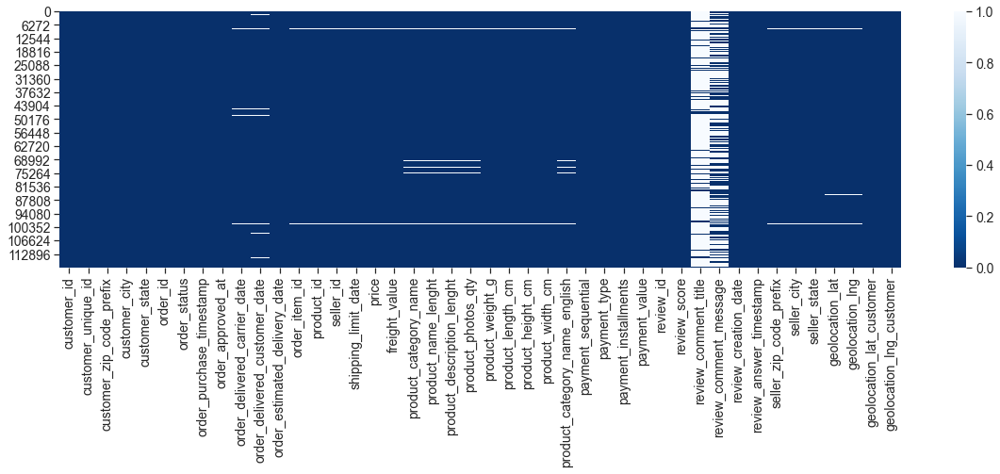

In [259]:
plt.figure(figsize=(20, 5))
sns.heatmap(data.isna(), cmap="Blues_r")

## Form analysis of merged data

In [578]:
df0 = data.copy()

- Visualizing few entries :

In [98]:
df0.iloc[119149, :].T

customer_id                      56b18e2166679b8a959d72dd06da27f9
customer_unique_id               73c2643a0a458b49f58cea58833b192e
customer_zip_code_prefix                                    92120
customer_city                                              canoas
customer_state                                                 RS
order_id                         e31ec91cea1ecf97797787471f98a8c2
order_status                                            delivered
order_purchase_timestamp                      2017-11-03 21:08:33
order_approved_at                             2017-11-03 21:31:20
order_delivered_carrier_date                  2017-11-06 18:24:41
order_delivered_customer_date                 2017-11-16 19:58:39
order_estimated_delivery_date                 2017-12-05 00:00:00
order_item_id                                                 1.0
product_id                       f819f0c84a64f02d3a5606ca95edd272
seller_id                        4869f7a5dfa277a7dca6462dcf3b52b2
shipping_l

In [579]:
df0.shape
(len(df0) - len(df0.drop_duplicates()))/len(df0)
df0.isna().sum().sum()/df0.size
(df0.isna().sum()/df0.size).sort_values(ascending=False).head()
df0.dtypes.value_counts()/len(df0.columns)

(119151, 44)

0.0

0.039110609074352556

review_comment_title             0.020021
review_comment_message           0.012952
order_delivered_customer_date    0.000653
product_category_name_english    0.000490
product_category_name            0.000485
dtype: float64

object     0.545455
float64    0.409091
int64      0.045455
dtype: float64

In [244]:
df0["review_score"].describe()

count    119151.000000
mean          3.998514
std           1.412529
min           1.000000
25%           3.000000
50%           5.000000
75%           5.000000
max           5.000000
Name: review_score, dtype: float64

# Data cleaning

## Aggregation and reduction

### Geodesic distance between customer and seller

- We want calculate a variable called "distance" (geodesic) between seller and customer from lat/Lng GPS data.
- Considering two points A and B, the geodesic distance writes:
    - distance = 6 378 * arccos(sin(latA) * sin(latB) + cos(latA) * cos(latB) * cos(LngB-LngB))

In [609]:
latA = np.radians(df0["geolocation_lat_customer"])
LngA = np.radians(df0["geolocation_lng_customer"])
latB = np.radians(df0["geolocation_lat"])
LngB = np.radians(df0["geolocation_lng"])

df1 = df0.copy()
df1["distance"] = 6378 * np.arccos(np.sin(latA)
                                   * np.sin(latB)
                                   + np.cos(latA)
                                   * np.cos(latB)
                                   * np.cos(LngB-LngA)
                                   )

C:\Anaconda3\lib\site-packages\pandas\core\arraylike.py:364: RuntimeWarning: invalid value encountered in arccos
  result = getattr(ufunc, method)(*inputs, **kwargs)


- This computation has warnings because some missing values are found
- Half+ of them correspond to non-issued order_status

In [581]:
df1["order_status"][df1["distance"].isna()].value_counts()

unavailable    645
delivered      564
canceled       186
shipped          8
invoiced         6
created          5
processing       1
Name: order_status, dtype: int64

### Product volume

- The aim here is to compute the product volume = length * width * height

In [610]:
length = df1["product_length_cm"]
width = df1["product_width_cm"]
height = df1["product_height_cm"]

df1["product_volume"] = length * width * height / 1000 # volume in liters

### Timings

#### Time purchase-to-delivery (days)

In [612]:
t_purchase = pd.to_datetime(df1["order_purchase_timestamp"])
t_delivery = pd.to_datetime(df1["order_delivered_customer_date"])

df1["t_purchase_delivery"] = (
    t_delivery - t_purchase).dt.days + (t_delivery - t_purchase).dt.components.hours/24

#### Time expected_delivery-to-delivery (days)

In [613]:
t_expected = pd.to_datetime(df1["order_estimated_delivery_date"])
t_delivery = pd.to_datetime(df1["order_delivered_customer_date"])

df1["t_expected_delivery"] = (
    t_delivery - t_expected).dt.days + (t_delivery - t_expected).dt.components.hours/24

#### Time delivery-to-review (days)

In [614]:
t_review = pd.to_datetime(df1["review_creation_date"])
t_delivery = pd.to_datetime(df1["order_delivered_customer_date"])

df1["t_delivery_review"] = (
    t_review - t_delivery).dt.days + (t_review - t_delivery).dt.components.hours/24

#### Time review-to-answer (days)

In [615]:
t_review = pd.to_datetime(df1["review_creation_date"])
t_answer = pd.to_datetime(df1["review_answer_timestamp"])

df1["t_answer_review"] = (
    t_answer - t_review).dt.days + (t_answer - t_review).dt.components.hours/24

### Review length

In [616]:
x = (df1["review_comment_message"].fillna(""))
y = (df1["review_comment_title"].fillna(""))

for i in df1.index:
    if (x[i] != "") or (y[i] != ""):
        df1.loc[i, "review_length"] = len(x[i])+len(y[i])
    else:
        df1.loc[i, "review_length"] = 0

df1["review_length"]

0          0.0
1          0.0
2          0.0
3          0.0
4         58.0
          ... 
119146     9.0
119147     0.0
119148    76.0
119149     0.0
119150    61.0
Name: review_length, Length: 119151, dtype: float64

### Cities

In [617]:
cities = pd.read_csv(PATH+"\BRAZIL_CITIES.csv", sep=';')
cities.shape
cities = cities.drop_duplicates(subset="CITY")
cities["POST_OFFICES"] = cities["POST_OFFICES"].fillna(0)
cities.shape
cities.iloc[0, :].T.head(41)
cities.iloc[0, :].T.tail(40)
cities = cities[["CITY",
                 "STATE",
                 "IBGE_RES_POP",
                 "GDP_CAPITA",
                 "RURAL_URBAN",
                 "POST_OFFICES", ]]

(5573, 81)

(5299, 81)

CITY                      Abadia De Goiás
STATE                                  GO
CAPITAL                                 0
IBGE_RES_POP                       6876.0
IBGE_RES_POP_BRAS                  6876.0
IBGE_RES_POP_ESTR                     0.0
IBGE_DU                            2137.0
IBGE_DU_URBAN                      1546.0
IBGE_DU_RURAL                       591.0
IBGE_POP                           5300.0
IBGE_1                               69.0
IBGE_1-4                            318.0
IBGE_5-9                            438.0
IBGE_10-14                          517.0
IBGE_15-59                         3542.0
IBGE_60+                            416.0
IBGE_PLANTED_AREA                   319.0
IBGE_CROP_PRODUCTION_$             1843.0
IDHM Ranking 2010                  1689.0
IDHM                                0.708
IDHM_Renda                          0.687
IDHM_Longevidade                     0.83
IDHM_Educacao                       0.622
LONG                           -49

GDP_CAPITA                20664.57
GVA_MAIN           Demais serviços
MUN_EXPENDIT            28227691.0
COMP_TOT                     284.0
COMP_A                         5.0
COMP_B                         1.0
COMP_C                        56.0
COMP_D                         0.0
COMP_E                         2.0
COMP_F                        29.0
COMP_G                       110.0
COMP_H                        26.0
COMP_I                         4.0
COMP_J                         5.0
COMP_K                         0.0
COMP_L                         2.0
COMP_M                        10.0
COMP_N                        12.0
COMP_O                         4.0
COMP_P                         6.0
COMP_Q                         6.0
COMP_R                         1.0
COMP_S                         5.0
COMP_T                         0.0
COMP_U                         0.0
HOTELS                         NaN
BEDS                           NaN
Pr_Agencies                    NaN
Pu_Agencies         

It seems that the city names in our dataset are all in lower and ASCII encoded, so let's do the same for the cities dataset:

In [618]:
from unidecode import unidecode


def lower_and_ascii(string):
    return unidecode(string.lower())


assert lower_and_ascii('AEéç') == 'aeec'

cities['CITY'] = cities.apply(lambda row: lower_and_ascii(row['CITY']), axis=1)

In [619]:
cities

,CITY,STATE,IBGE_RES_POP,GDP_CAPITA,RURAL_URBAN,POST_OFFICES
0,abadia de goias,GO,6876.0,20664.57,Urbano,1.0
1,abadia dos dourados,MG,6704.0,25591.70,Rural Adjacente,1.0
2,abadiania,GO,15757.0,15628.40,Rural Adjacente,3.0
3,abaete,MG,22690.0,18250.42,Urbano,4.0
4,abaetetuba,PA,141100.0,8222.36,Urbano,2.0
...,...,...,...,...,...,...
5568,xique-xique,BA,45536.0,7089.97,Urbano,2.0
5569,zabele,PB,2075.0,8793.02,Rural Adjacente,0.0
5570,zacarias,SP,2335.0,29149.67,Rural Adjacente,1.0
5571,ze doca,MA,50173.0,7489.46,Urbano,1.0


In [620]:
df1 = pd.merge(df1, cities, how="left",
               left_on="customer_city", right_on="CITY")

### Customer behavior: RFM features

- The aim here is to extract useful infos from the dataset about consumption habits
- RFM is a method used for analyzing customer value. It is commonly used in database marketing and direct marketing and has received particular attention in retail and professional services industries.
RFM stands for the three dimensions:
    - Recency – How recently did the customer purchase?
    - Frequency – How often do they purchase?
    - Monetary Value – How much do they spend?
- Some possibly interesting aggregations:
    - **mean_item_per_order**: the average number of item per order
    - **price_max_per_item**
    - **price_mean_per_item**
    - **mean_payment_value**
    - **date_last_order**
- To implement these aggregations, we use groupby and merge function of Pandas

- Here the groupby

In [840]:
# computing the frequency by counting the number of different orders (customer_id)
n_order = df1[["customer_unique_id", "customer_id"]
              ].groupby(["customer_unique_id"]).nunique()

# the frequency by counting the number of different orders (customer_id)
total_item = df1[["customer_unique_id", "customer_id"]
                 ].groupby(["customer_unique_id"]).count()

mean_item_per_order = total_item/n_order
n_order.rename(
    columns={"customer_id": "n_order"}, inplace=True)
mean_item_per_order.rename(
    columns={"customer_id": "mean_item_per_order"}, inplace=True)


price_max_per_item = df1[["customer_unique_id", "price"]].groupby(
    ["customer_unique_id"]).max()
price_max_per_item.rename(
    columns={"price": "price_max_per_item"}, inplace=True)


price_mean_item = df1[["customer_unique_id", "price"]
                      ].groupby(["customer_unique_id"]).mean()
price_mean_item.rename(columns={"price": "price_mean_item"}, inplace=True)


mean_payment_value = df1[["customer_unique_id", "payment_value"]].groupby(
    ["customer_unique_id"]).min()
mean_payment_value.rename(
    columns={"payment_value": "mean_payment_value"}, inplace=True)


date_last_order = df1[["customer_unique_id", "order_purchase_timestamp"]].groupby(
    ["customer_unique_id"]).max().astype(np.datetime64)
date_last_order.rename(
    columns={"order_purchase_timestamp": "date_last_order"}, inplace=True)

- parsing date of last purchase and cast into strings

In [859]:
def _parse_date(date_time):
    try:
        return pd.Series([date_time.year,
                          date_time.month,
                          date_time.day,
                          date_time.isoweekday(),
                          date_time.time()
                          ])
    except:
        return pd.Series([0, 0, 0, 0, 0])


def parse_date_columns(df):
    time_cols = ["date_last_order"]
    result = df.copy()
    for col in time_cols:
        result[col] = pd.to_datetime(
            result[col], errors='ignore', format="%Y-%m-%d %H:%M:%S")
        feature_cols = [f'{col}_{item}' for item in [
            'year', 'month', 'day', 'weekday', 'time']]
        result[feature_cols] = result[col].apply(_parse_date)
    result.drop(time_cols, axis=1, inplace=True)
    return result

In [862]:
 date_last_order = parse_date_columns(date_last_order).astype("string")

In [867]:
date_last_order.drop(columns=["date_last_order_time"], inplace=True)

KeyError: "['date_last_order_time'] not found in axis"

In [868]:
date_last_order

,date_last_order_year,date_last_order_month,date_last_order_day,date_last_order_weekday
customer_unique_id,,,,
0000366f3b9a7992bf8c76cfdf3221e2,2018,5,10,4
0000b849f77a49e4a4ce2b2a4ca5be3f,2018,5,7,1
0000f46a3911fa3c0805444483337064,2017,3,10,5
0000f6ccb0745a6a4b88665a16c9f078,2017,10,12,4
0004aac84e0df4da2b147fca70cf8255,2017,11,14,2
...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,2017,6,8,4
fffea47cd6d3cc0a88bd621562a9d061,2017,12,10,7
ffff371b4d645b6ecea244b27531430a,2017,2,7,2


- Mergeing all previously constructed df

In [869]:
from functools import reduce

data_frames = [mean_item_per_order,
               price_max_per_item,
               price_mean_item,
               mean_payment_value,
               n_order,
               date_last_order]

df_merged = reduce(lambda left, right: pd.merge(left, right, on=["customer_unique_id"],
                                                how='outer'), data_frames)

- Final mergeing with core df

In [870]:
df2 = pd.merge(df1, df_merged, how="left", on="customer_unique_id")

In [871]:
df2

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,...,POST_OFFICES,mean_item_per_order,price_max_per_item,price_mean_item,mean_payment_value,n_order,date_last_order_year,date_last_order_month,date_last_order_day,date_last_order_weekday
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,...,3.0,1.0,124.99,124.99,146.87,1,2017,5,16,2
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,...,12.0,1.0,289.00,289.00,335.48,1,2018,1,12,5
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,...,225.0,1.0,139.94,139.94,157.73,1,2018,5,19,6
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,...,6.0,1.0,149.94,149.94,173.30,1,2018,3,13,2
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,...,27.0,1.0,230.00,230.00,252.25,1,2018,7,29,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119231,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,2018-04-07 15:48:17,2018-04-07 16:08:45,2018-04-11 02:08:36,...,225.0,1.0,74.90,74.90,88.78,1,2018,4,7,6
119232,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,2018-04-04 08:20:22,2018-04-04 08:35:12,2018-04-05 18:42:35,...,4.0,1.0,114.90,114.90,129.06,1,2018,4,4,3
119233,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE,fed4434add09a6f332ea398efd656a5c,delivered,2018-04-08 20:11:50,2018-04-08 20:30:03,2018-04-09 17:52:17,...,40.0,1.0,37.00,37.00,56.04,1,2018,4,8,7
119234,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS,e31ec91cea1ecf97797787471f98a8c2,delivered,2017-11-03 21:08:33,2017-11-03 21:31:20,2017-11-06 18:24:41,...,4.0,1.0,689.00,689.00,711.07,1,2017,11,3,5


- Export this dataframe

In [872]:
df2.to_csv("df2.csv", index=False)

## Variable selection

### Make a new df (df3) with cleaned data

In [875]:
df2.iloc[0,:].T.head(34)

customer_id                      06b8999e2fba1a1fbc88172c00ba8bc7
customer_unique_id               861eff4711a542e4b93843c6dd7febb0
customer_zip_code_prefix                                    14409
customer_city                                              franca
customer_state                                                 SP
order_id                         00e7ee1b050b8499577073aeb2a297a1
order_status                                            delivered
order_purchase_timestamp                      2017-05-16 15:05:35
order_approved_at                             2017-05-16 15:22:12
order_delivered_carrier_date                  2017-05-23 10:47:57
order_delivered_customer_date                 2017-05-25 10:35:35
order_estimated_delivery_date                 2017-06-05 00:00:00
order_item_id                                                 1.0
product_id                       a9516a079e37a9c9c36b9b78b10169e8
seller_id                        7c67e1448b00f6e969d365cea6b010ab
shipping_l

In [876]:
df2.iloc[0,:].T.tail(33)

review_comment_message                      NaN
review_creation_date        2017-05-26 00:00:00
review_answer_timestamp     2017-05-30 22:34:40
seller_zip_code_prefix                   8577.0
seller_city                     itaquaquecetuba
seller_state                                 SP
geolocation_lat                      -23.486111
geolocation_lng                      -46.366721
geolocation_lat_customer             -20.498489
geolocation_lng_customer             -47.396929
distance                              349.15386
product_volume                          107.136
weekday_purchase                              1
t_purchase_delivery                    8.791667
t_expected_delivery                  -10.583333
t_delivery_review                      0.541667
t_answer_review                        4.916667
review_length                               0.0
CITY                                     franca
STATE                                        SP
IBGE_RES_POP                           3

In [878]:
df3 = df2[[
    "customer_unique_id",
    "customer_id",
    "customer_zip_code_prefix",
    "customer_city",
    "customer_state",
    "IBGE_RES_POP",
    "GDP_CAPITA",
    "RURAL_URBAN",
    "POST_OFFICES",
    "seller_zip_code_prefix",
    "seller_city",
    "seller_state",
    "weekday_purchase",
    "distance",
    "mean_item_per_order",
    "product_volume",
    "price",
    "price_max_per_item",
    "price_mean_item",
    "product_category_name_english",
    "payment_sequential",
    "payment_type",
    "payment_installments",
    "payment_value",
    "order_purchase_timestamp",
    "t_purchase_delivery",
    "t_expected_delivery",
    "t_delivery_review",
    "t_answer_review",
    "review_score",
    "review_length",
    "mean_payment_value",
    "n_order",
    "date_last_order_year",
    "date_last_order_month",
    "date_last_order_day",
    "date_last_order_weekday"]].dropna()

df3.rename(columns={"IBGE_RES_POP": "customer_city_pop"}, inplace=True)

In [879]:
df3.to_csv("data_cleaned.csv", index=False)

In [880]:
df3.iloc[0,:].T

customer_unique_id               861eff4711a542e4b93843c6dd7febb0
customer_id                      06b8999e2fba1a1fbc88172c00ba8bc7
customer_zip_code_prefix                                    14409
customer_city                                              franca
customer_state                                                 SP
customer_city_pop                                        318640.0
GDP_CAPITA                                               28108.23
RURAL_URBAN                                                Urbano
POST_OFFICES                                                  3.0
seller_zip_code_prefix                                     8577.0
seller_city                                       itaquaquecetuba
seller_state                                                   SP
weekday_purchase                                                1
distance                                                349.15386
mean_item_per_order                                           1.0
product_vo

### Create dfs to be used for ML - groupedby customer_unique_id

- Select interesting features and separate cat/num into two dfs

In [882]:
df_num = df3[["customer_unique_id",
              "customer_zip_code_prefix",
              "customer_city_pop",
              "GDP_CAPITA",
              "weekday_purchase",
              "distance",
              "n_order",
              "mean_item_per_order",
              "product_volume",
              "price_mean_item",
              "mean_payment_value",
              "payment_sequential",
              "payment_installments",
              "review_score",
              "review_length",
              "t_delivery_review",
              ]]

df_cat = df3[["customer_unique_id",
              "payment_type",
              "RURAL_URBAN",
              "customer_state",
              "product_category_name_english",
              "customer_city",
              "date_last_order_year",
              "date_last_order_month",
              "date_last_order_day",
              "date_last_order_weekday",
              ]]

- We want that each row correspond to a unique customer
- We group the num data by the median (avoiding healf weekdays for example)
- We group the cat data by the most frequent apparition of each feature

In [883]:
df_num_gped = df_num.groupby("customer_unique_id").median()
df_cat_gped = df_cat.groupby("customer_unique_id").agg(lambda x:x.value_counts().index[0])

df_num_gped = df_num_gped.reset_index()
df_cat_gped = df_cat_gped.reset_index()
df_gped = pd.merge(df_num_gped, df_cat_gped, how="inner", on="customer_unique_id")

df_gped.to_csv("df_gped.csv", index=False)

# Data exploration

## Split cat and num variables

In [14]:
num_col = df3.select_dtypes(include=np.number).columns
cat_col = df3.select_dtypes(exclude=np.number).columns

In [533]:
df3[cat_col]
df3[num_col]

,customer_unique_id,customer_id,customer_city,customer_state,RURAL_URBAN,seller_city,seller_state,order_status,product_category_name_english,payment_type,order_purchase_timestamp
0,861eff4711a542e4b93843c6dd7febb0,06b8999e2fba1a1fbc88172c00ba8bc7,franca,SP,Urbano,itaquaquecetuba,SP,delivered,office_furniture,credit_card,2017-05-16 15:05:35
1,290c77bc529b7ac935b93aa66c333dc3,18955e83d337fd6b2def6b18a428ac77,sao bernardo do campo,SP,Urbano,itajai,SC,delivered,housewares,credit_card,2018-01-12 20:48:24
2,060e732b5b29e8181a18229c7b0b2b5e,4e7b3e00288586ebd08712fdd0374a03,sao paulo,SP,Urbano,itaquaquecetuba,SP,delivered,office_furniture,credit_card,2018-05-19 16:07:45
3,259dac757896d24d7702b9acbbff3f3c,b2b6027bc5c5109e529d4dc6358b12c3,mogi das cruzes,SP,Urbano,itaquaquecetuba,SP,delivered,office_furniture,credit_card,2018-03-13 16:06:38
4,345ecd01c38d18a9036ed96c73b8d066,4f2d8ab171c80ec8364f7c12e35b23ad,campinas,SP,Urbano,ibitinga,SP,delivered,home_confort,credit_card,2018-07-29 09:51:30
...,...,...,...,...,...,...,...,...,...,...,...
119231,1a29b476fee25c95fbafc67c5ac95cf8,17ddf5dd5d51696bb3d7c6291687be6f,sao paulo,SP,Urbano,garca,SP,delivered,books_general_interest,credit_card,2018-04-07 15:48:17
119232,d52a67c98be1cf6a5c84435bd38d095d,e7b71a9017aa05c9a7fd292d714858e8,taboao da serra,SP,Urbano,araraquara,SP,delivered,sports_leisure,credit_card,2018-04-04 08:20:22
119233,e9f50caf99f032f0bf3c55141f019d99,5e28dfe12db7fb50a4b2f691faecea5e,fortaleza,CE,Urbano,sao paulo,SP,delivered,health_beauty,credit_card,2018-04-08 20:11:50
119234,73c2643a0a458b49f58cea58833b192e,56b18e2166679b8a959d72dd06da27f9,canoas,RS,Urbano,guariba,SP,delivered,watches_gifts,credit_card,2017-11-03 21:08:33


,customer_zip_code_prefix,cust_city_population,GDP_CAPITA,POST_OFFICES,seller_zip_code_prefix,distance,mean_item_per_order,price,price_max_per_item,price_mean_item,price_min_per_item,payment_sequential,payment_installments,payment_value,t_purchase_delivery,t_expected_delivery,t_delivery_review,t_answer_review,review_score,review_length
0,14409,318640.0,28108.23,3.0,8577.0,349.153860,1.0,124.99,124.99,124.99,124.99,1.0,2.0,146.87,8.791667,-10.583333,0.541667,4.916667,4,0
1,9790,765463.0,51239.64,12.0,88303.0,414.286425,1.0,289.00,289.00,289.00,289.00,1.0,8.0,335.48,16.625000,-7.500000,0.458333,11.916667,5,0
2,1151,11253503.0,57071.43,225.0,8577.0,29.989769,1.0,139.94,139.94,139.94,139.94,1.0,7.0,157.73,26.041667,1.708333,0.250000,0.500000,5,0
3,8775,387779.0,33602.58,6.0,8577.0,18.589746,1.0,149.94,149.94,149.94,149.94,1.0,1.0,173.30,14.958333,-12.333333,0.291667,4.750000,5,0
4,13056,1080113.0,49876.62,27.0,14940.0,220.289043,1.0,230.00,230.00,230.00,230.00,1.0,8.0,252.25,11.458333,-5.166667,0.125000,7.041667,5,58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119231,3937,11253503.0,57071.43,225.0,17400.0,358.239126,1.0,74.90,74.90,74.90,74.90,1.0,6.0,88.78,6.166667,-11.166667,0.125000,14.458333,4,9
119232,6764,244528.0,30259.41,4.0,14802.0,251.262981,1.0,114.90,114.90,114.90,114.90,1.0,3.0,129.06,7.416667,-8.250000,0.208333,4.416667,5,0
119233,60115,2452185.0,23045.09,40.0,3304.0,2369.765363,1.0,37.00,37.00,37.00,37.00,1.0,5.0,56.04,30.916667,7.791667,-5.833333,4.041667,1,76
119234,92120,323827.0,56995.33,4.0,14840.0,1000.124244,1.0,689.00,689.00,689.00,689.00,1.0,2.0,711.07,12.916667,-18.208333,0.166667,2.958333,5,0


## Num variables

### Univariate analysis - num variable

In [641]:
len(num_col)

23

In [1]:
df3["n_order"]

NameError: name 'sns' is not defined

<Figure size 1080x1080 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'customer_zip_code_prefix')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'cust_city_population')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'GDP_CAPITA')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'POST_OFFICES')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'seller_zip_code_prefix')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'weekday_purchase')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'distance')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'n_order')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'mean_item_per_order')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'product_volume')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'price')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'price_max_per_item')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'price_mean_item')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'price_min_per_item')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'payment_sequential')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'payment_installments')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'payment_value')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 't_purchase_delivery')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 't_expected_delivery')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 't_delivery_review')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 't_answer_review')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'review_score')

([], [])

<AxesSubplot:>

<AxesSubplot:>

Text(0, 0.5, '')

Text(0.5, 0, 'review_length')

([], [])

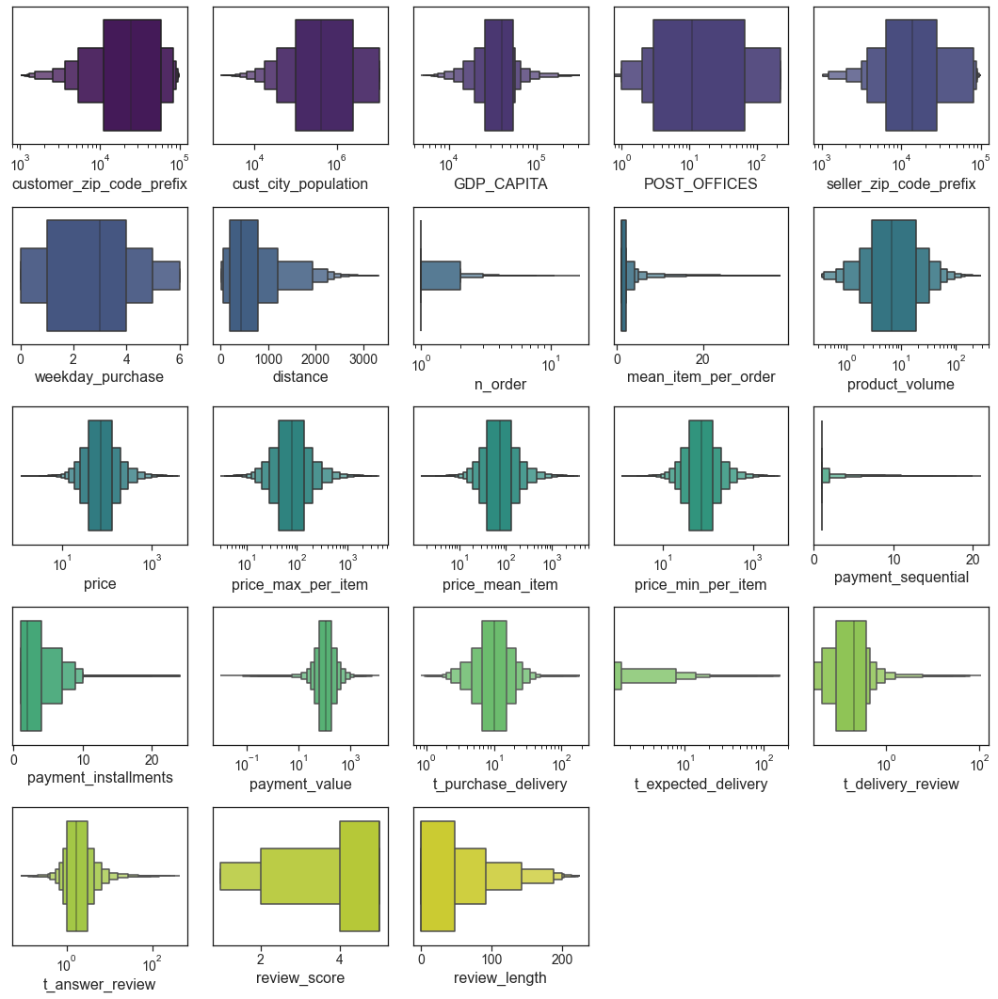

In [653]:
i = 1
n = len(num_col)

plt.figure(figsize=(15, 15))

for col in num_col:
    plt.subplot(5, 5, i)
    sns.boxenplot(data=df3[col], orient="h",
                  showfliers=False,
                  color=sns.color_palette("viridis", n_colors=n)[i-1],
                  label=col)
    if col in ["weekday_purchase",  "mean_item_per_order", "distance", 
               "payment_sequential", "payment_installments",
               "review_score", "review_length"]:
        plt.xscale("linear")
    else:
        plt.xscale("log")
    plt.ylabel("")
    plt.xlabel(col)
    plt.yticks(ticks=[], labels="")
    i += 1

plt.tight_layout(pad=1)
plt.show()

### Bivariate analysis - num variable

In [795]:
np.abs(df3[num_col].corr())

,customer_zip_code_prefix,cust_city_population,GDP_CAPITA,POST_OFFICES,seller_zip_code_prefix,weekday_purchase,distance,n_order,mean_item_per_order,product_volume,...,price_min_per_item,payment_sequential,payment_installments,payment_value,t_purchase_delivery,t_expected_delivery,t_delivery_review,t_answer_review,review_score,review_length
customer_zip_code_prefix,1.000000,0.464346,0.241069,0.442618,0.075648,0.002664,0.487940,0.011313,0.023997,0.002567,...,0.042604,0.029258,0.058355,0.052521,0.272264,0.076038,0.019857,0.007403,0.026769,0.003763
cust_city_population,0.464346,1.000000,0.312985,0.996729,0.027799,0.002755,0.269487,0.022469,0.045389,0.014320,...,0.026883,0.029267,0.059204,0.023900,0.168759,0.042388,0.014366,0.011817,0.011758,0.010983
GDP_CAPITA,0.241069,0.312985,1.000000,0.317811,0.007168,0.004962,0.308399,0.011095,0.030832,0.010973,...,0.028928,0.009247,0.053025,0.030104,0.166287,0.036475,0.017594,0.009054,0.012397,0.021130
POST_OFFICES,0.442618,0.996729,0.317811,1.000000,0.024653,0.002969,0.274325,0.023269,0.045039,0.014965,...,0.027197,0.028206,0.058899,0.023976,0.172738,0.041127,0.016555,0.012347,0.013291,0.012957
seller_zip_code_prefix,0.075648,0.027799,0.007168,0.024653,1.000000,0.001017,0.170171,0.004467,0.009267,0.005635,...,0.085896,0.004746,0.037818,0.068996,0.048381,0.118266,0.004099,0.010232,0.026678,0.013865
weekday_purchase,0.002664,0.002755,0.004962,0.002969,0.001017,1.000000,0.009880,0.005690,0.004729,0.000787,...,0.001136,0.002593,0.027091,0.006810,0.030611,0.031077,0.004888,0.000472,0.012249,0.001681
distance,0.487940,0.269487,0.308399,0.274325,0.170171,0.009880,1.000000,0.008332,0.025939,0.011059,...,0.087021,0.013899,0.085787,0.091492,0.392832,0.078157,0.059210,0.011334,0.057034,0.029359
n_order,0.011313,0.022469,0.011095,0.023269,0.004467,0.005690,0.008332,1.000000,0.048603,0.012260,...,0.066964,0.021750,0.031790,0.002558,0.013079,0.022238,0.013556,0.006865,0.014395,0.016523
mean_item_per_order,0.023997,0.045389,0.030832,0.045039,0.009267,0.004729,0.025939,0.048603,1.000000,0.033354,...,0.052874,0.633507,0.017886,0.122792,0.009236,0.019768,0.043722,0.000751,0.097902,0.038834
product_volume,0.002567,0.014320,0.010973,0.014965,0.005635,0.000787,0.011059,0.012260,0.033354,1.000000,...,0.290526,0.032775,0.158614,0.271756,0.079221,0.009623,0.019342,0.001984,0.025912,0.034621


<Figure size 720x504 with 0 Axes>

<AxesSubplot:>

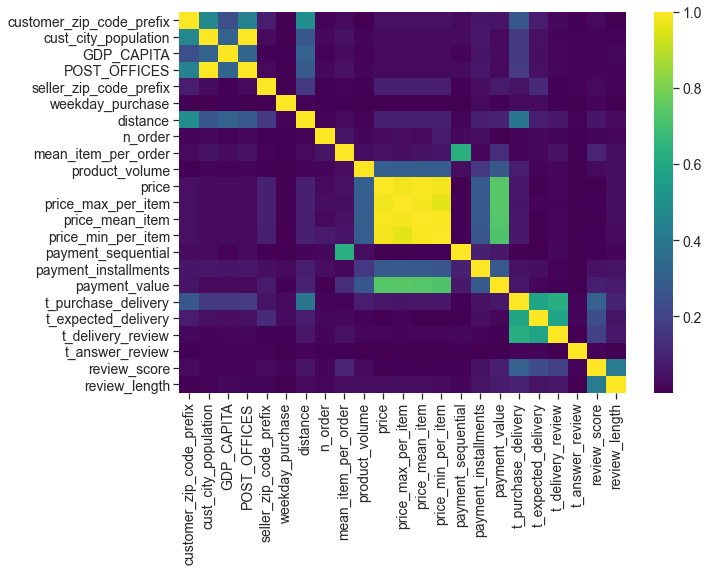

In [657]:
plt.figure(figsize=(10,7))
sns.heatmap(np.abs(df3[num_col].corr()), cmap="viridis")

In [566]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop


def get_top_neg_correlations(df, n=5):
    au_corr = df.corr()[df.corr() < 0].unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=True)
    return au_corr[0:n]


def get_top_pos_correlations(df, n=5):
    au_corr = df.corr()[df.corr() > 0].unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]


top_neg_corr = get_top_neg_correlations(df3[num_col], 20)
top_pos_corr = get_top_pos_correlations(df3[num_col], 20)

print("Top Negative Correlations")
print(top_neg_corr)
print("\n")
print("Top Positive Correlations")
print(top_pos_corr)

Top Negative Correlations
t_purchase_delivery       t_delivery_review      -0.627098
t_expected_delivery       t_delivery_review      -0.581459
customer_zip_code_prefix  cust_city_population   -0.464346
                          POST_OFFICES           -0.442618
review_score              review_length          -0.414419
GDP_CAPITA                distance               -0.308399
t_purchase_delivery       review_score           -0.305614
POST_OFFICES              distance               -0.274325
cust_city_population      distance               -0.269487
customer_zip_code_prefix  GDP_CAPITA             -0.241069
t_expected_delivery       review_score           -0.230390
POST_OFFICES              t_purchase_delivery    -0.172738
cust_city_population      t_purchase_delivery    -0.168759
GDP_CAPITA                t_purchase_delivery    -0.166287
seller_zip_code_prefix    t_expected_delivery    -0.118266
mean_item_per_order       review_score           -0.097902
payment_sequential        paym

## Cat variables

In [568]:
df3[cat_col].nunique().sort_values()

order_status                         2
payment_type                         4
RURAL_URBAN                          5
seller_state                        22
customer_state                      27
product_category_name_english       71
seller_city                        588
customer_city                     3814
customer_unique_id               91059
order_purchase_timestamp         93573
customer_id                      94067
dtype: int64

In [671]:
cat_col2 = ["payment_type",
            "RURAL_URBAN",
            "seller_state",
            "customer_state",
            "product_category_name_english"]

### Univariate analysis - cat var

<Figure size 360x504 with 0 Axes>

<AxesSubplot:xlabel='count', ylabel='payment_type'>

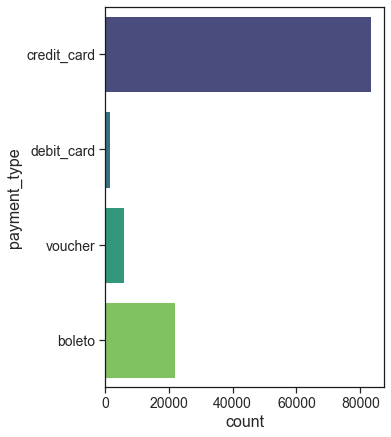

<Figure size 360x504 with 0 Axes>

<AxesSubplot:xlabel='count', ylabel='RURAL_URBAN'>

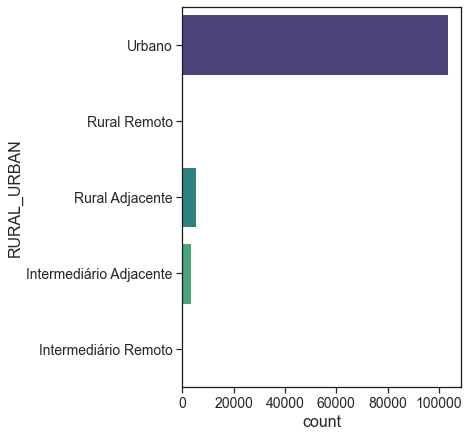

<Figure size 360x504 with 0 Axes>

<AxesSubplot:xlabel='count', ylabel='seller_state'>

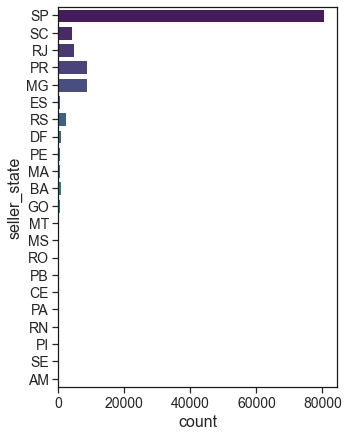

<Figure size 360x504 with 0 Axes>

<AxesSubplot:xlabel='count', ylabel='customer_state'>

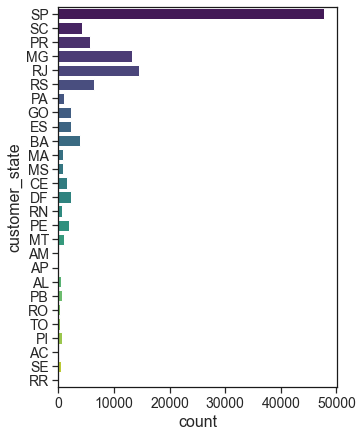

<Figure size 360x360 with 0 Axes>

C:\Anaconda3\lib\site-packages\seaborn\_core.py:1312: UserWarning: Horizontal orientation ignored with only `y` specified.
  warnings.warn(single_var_warning.format("Horizontal", "y"))


TypeError: object of type 'NoneType' has no len()

<Figure size 360x360 with 0 Axes>

In [681]:
for col in cat_col2[:-1]:
    plt.figure(figsize=(5, 7))
    sns.countplot(y=df3[col], palette="viridis", orient="h")
    plt.show()

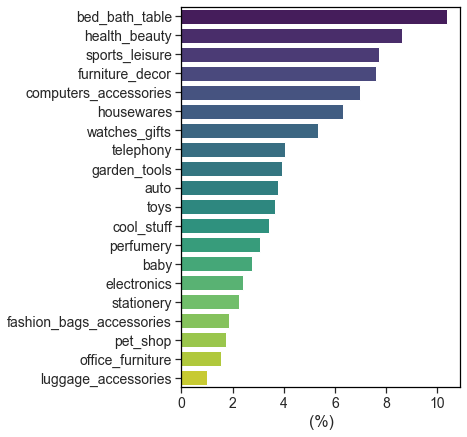

In [12]:
x = 100* df3["product_category_name_english"].value_counts(normalize=True)
plt.figure(figsize=(5, 7))
sns.barplot(x=x.head(20),
            y=x.head(20).index,
            palette="viridis",
            orient="h")
plt.xlabel("(%)")
plt.ylabel("")
plt.show()

### Bivariate analysis - cat var

<Figure size 504x864 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:>

<AxesSubplot:>

<AxesSubplot:>

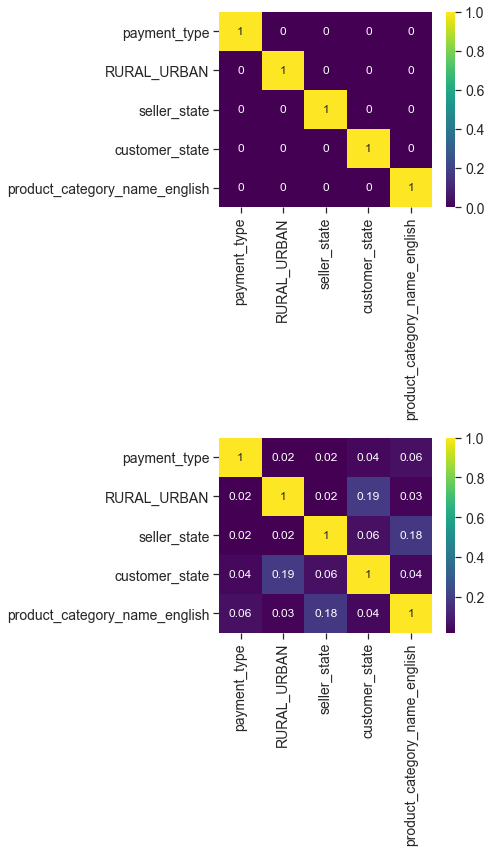

In [695]:
def cramers_corrected_stat(x, y):
    """ calculate Cramers V statistic for categorial-categorial association.
        uses correction from Bergsma and Wicher, 
        Journal of the Korean Statistical Society 42 (2013): 323-328
    """
    result = -1
    if len(x.value_counts()) == 1:
        print("First variable is constant")
    elif len(y.value_counts()) == 1:
        print("Second variable is constant")
    else:
        conf_matrix = pd.crosstab(x, y)

        if conf_matrix.shape[0] == 2:
            correct = False
        else:
            correct = True

        chi2 = stats.chi2_contingency(conf_matrix, correction=correct)[0]

        n = sum(conf_matrix.sum())
        phi2 = chi2/n
        r, k = conf_matrix.shape
        phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
        rcorr = r - ((r-1)**2)/(n-1)
        kcorr = k - ((k-1)**2)/(n-1)
        result = np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))
    return round(result, 6)


cramers_tab = pd.DataFrame(np.ones((5, 5), dtype=float))
chi2_tab = pd.DataFrame(np.ones((5, 5), dtype=float))

cramers_tab.columns = cat_col2
cramers_tab.index = cat_col2

chi2_tab.columns = cat_col2
chi2_tab.index = cat_col2

for col1 in cat_col2:
    for col2 in cat_col2:
        if col1 != col2:
            phi = cramers_corrected_stat(df3[col1], df3[col2])
            cramers_tab.loc[col1, col2] = round(phi, 2)

            ct = pd.crosstab(df3[col1], df3[col2], normalize=False)
            chi2, p, dof, ex = stats.chi2_contingency(ct, correction=False)
            chi2_tab.loc[col1, col2] = round(p, 2)

plt.figure(figsize=(7, 12))
plt.subplot(2, 1, 1)
sns.heatmap(chi2_tab, annot=True, cmap='viridis', annot_kws={"size": 12 })
plt.subplot(2, 1, 2)
sns.heatmap(cramers_tab, annot=True,  cmap='viridis', annot_kws={"size": 12})

plt.tight_layout(pad=0.8)
plt.show()

## Bivariate analysis: cat/num

In [808]:
df3[""]

23

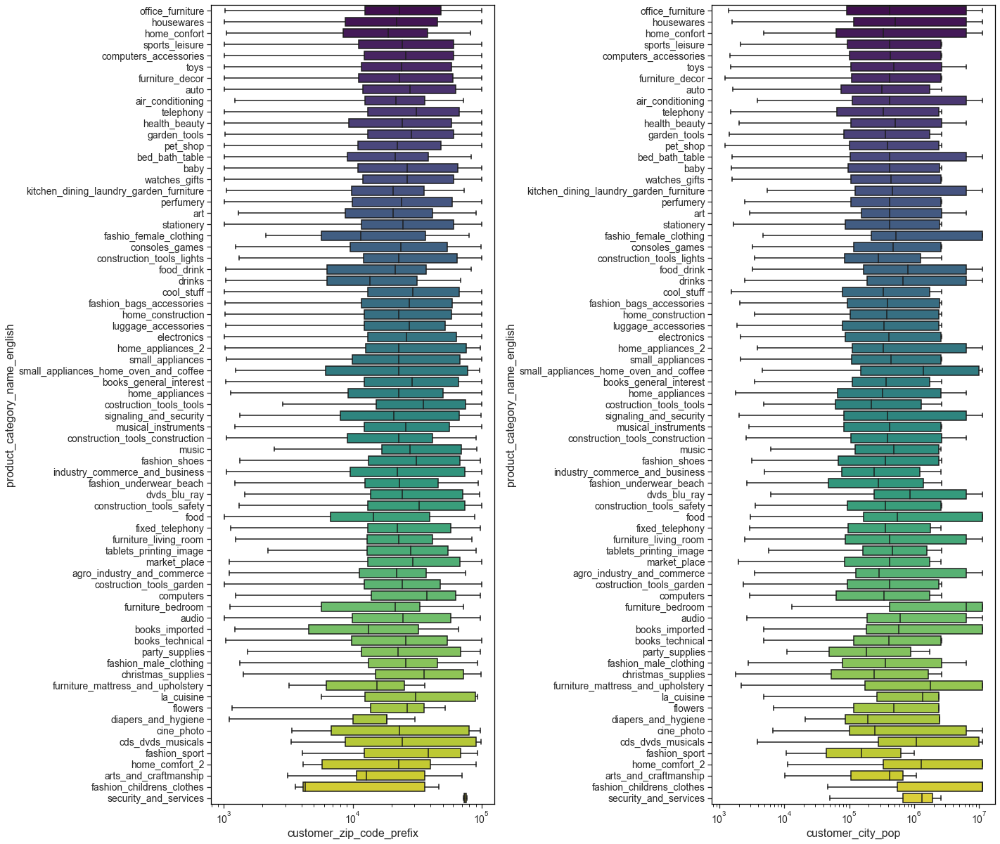

In [19]:
plt.figure(figsize=(20, 200))
i = 0
for col in num_col[:2]:
    plt.subplot(12, 2, i+1)
    sns.boxplot(data=df3,
                x=col,
                y="product_category_name_english",
                orient="h",
                showfliers=False,
                palette="viridis")
    i += 1
    plt.xscale("log")
plt.tight_layout(pad=1)
plt.show()

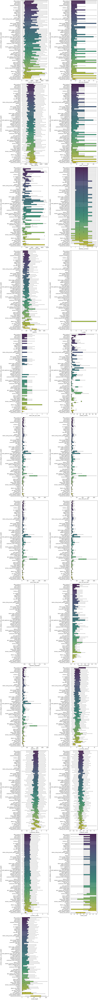

In [814]:
plt.figure(figsize=(20, 200))
i = 0
for col in num_col:
    plt.subplot(12, 2, i+1)
    sns.boxplot(data=df3,
                x=col,
                y="product_category_name_english",
                orient="h",
                showfliers=False,
                palette="viridis")
    i+=1
plt.tight_layout(pad=1)
plt.show()

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='customer_zip_code_prefix', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='customer_zip_code_prefix', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='customer_zip_code_prefix', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='customer_zip_code_prefix', ylabel='customer_state'>

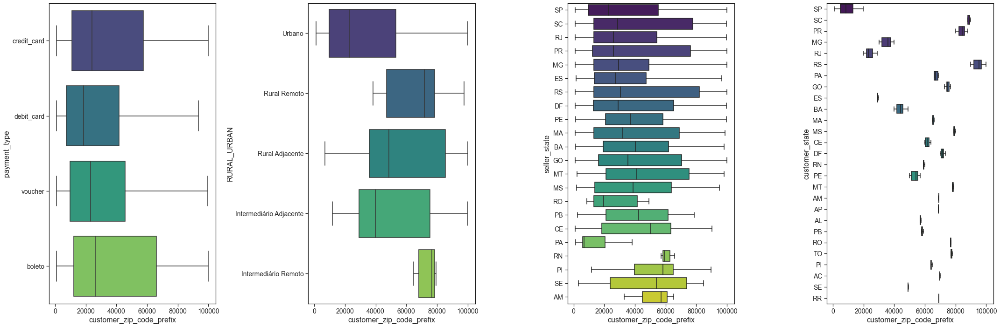

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='cust_city_population', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='cust_city_population', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='cust_city_population', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='cust_city_population', ylabel='customer_state'>

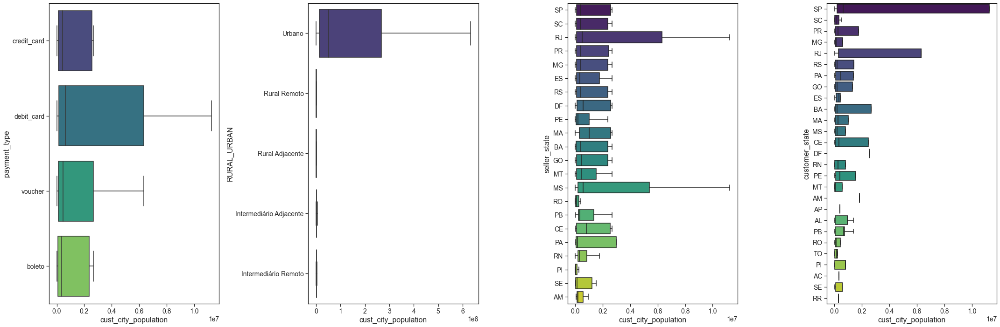

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='GDP_CAPITA', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='GDP_CAPITA', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='GDP_CAPITA', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='GDP_CAPITA', ylabel='customer_state'>

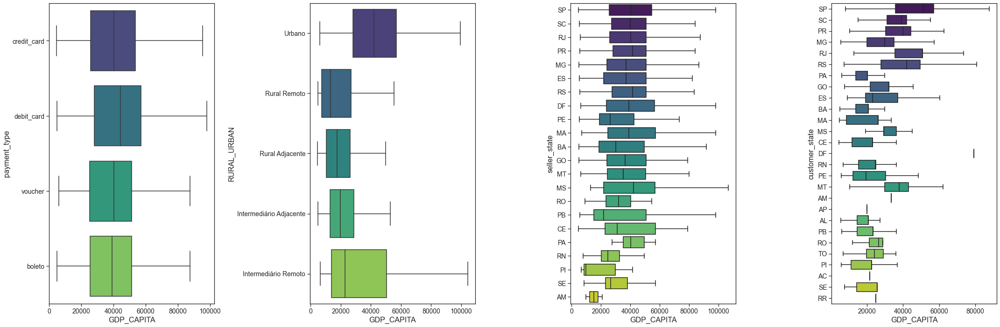

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='POST_OFFICES', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='POST_OFFICES', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='POST_OFFICES', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='POST_OFFICES', ylabel='customer_state'>

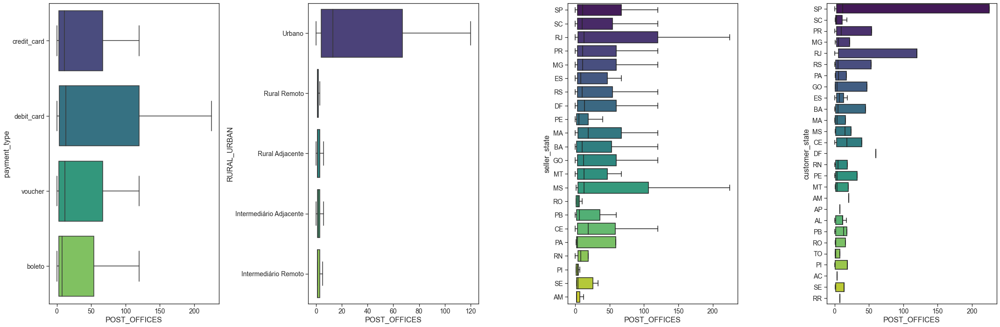

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='seller_zip_code_prefix', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='seller_zip_code_prefix', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='seller_zip_code_prefix', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='seller_zip_code_prefix', ylabel='customer_state'>

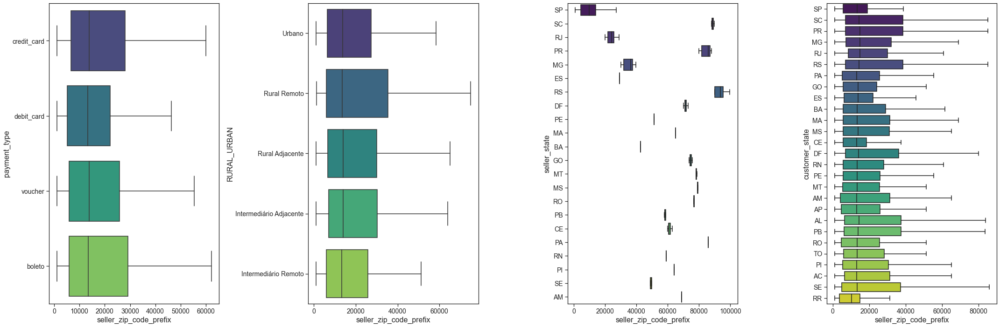

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='weekday_purchase', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='weekday_purchase', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='weekday_purchase', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='weekday_purchase', ylabel='customer_state'>

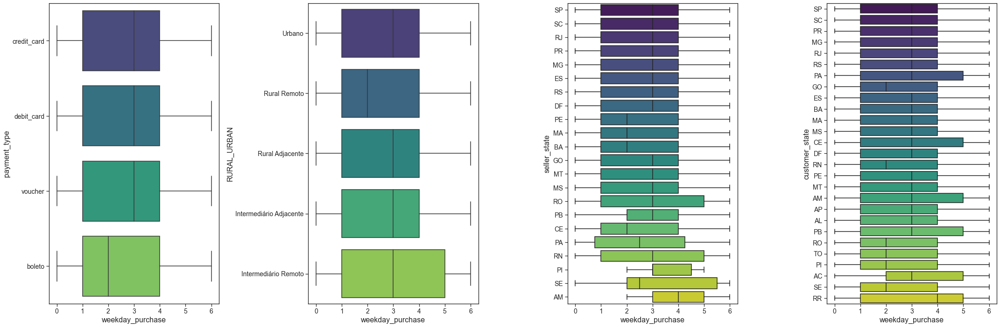

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='distance', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='distance', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='distance', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='distance', ylabel='customer_state'>

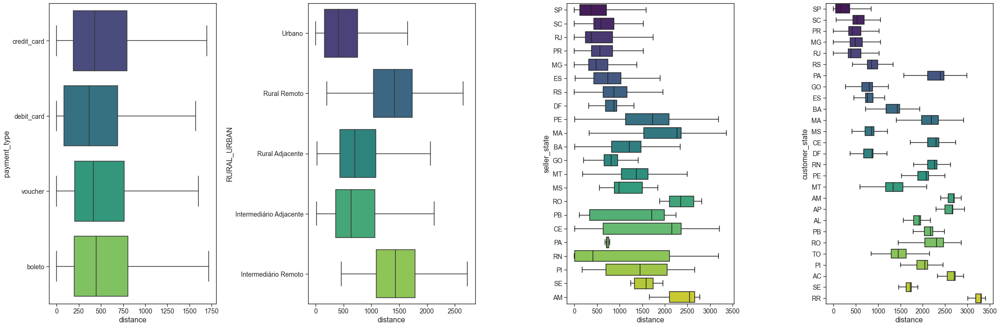

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='n_order', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='n_order', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='n_order', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='n_order', ylabel='customer_state'>

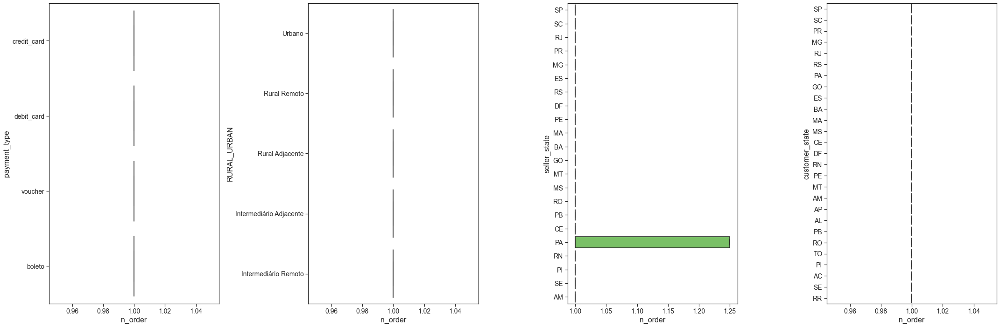

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='mean_item_per_order', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='mean_item_per_order', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='mean_item_per_order', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='mean_item_per_order', ylabel='customer_state'>

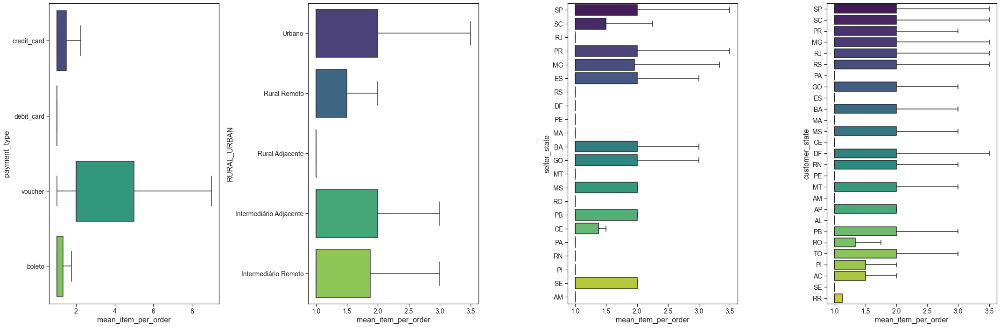

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='product_volume', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='product_volume', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='product_volume', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='product_volume', ylabel='customer_state'>

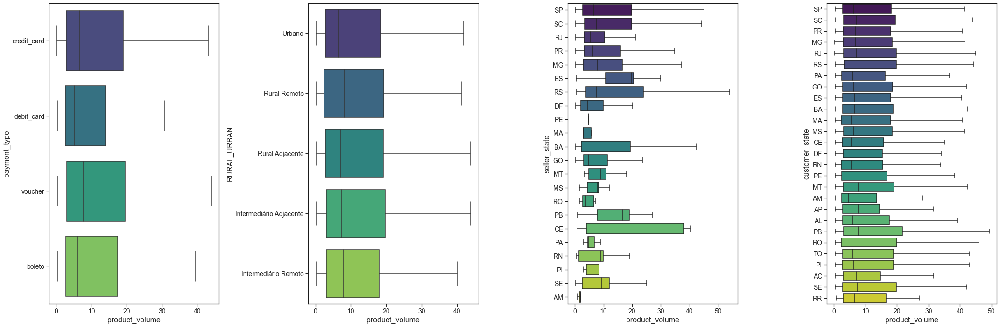

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='price', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='price', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='price', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='price', ylabel='customer_state'>

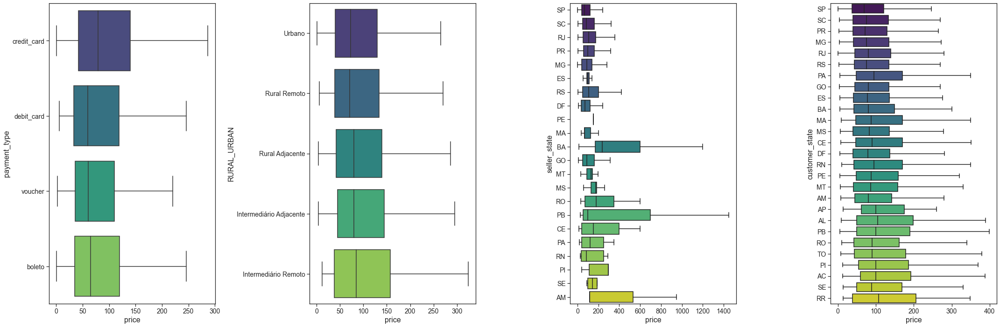

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='price_max_per_item', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_max_per_item', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_max_per_item', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_max_per_item', ylabel='customer_state'>

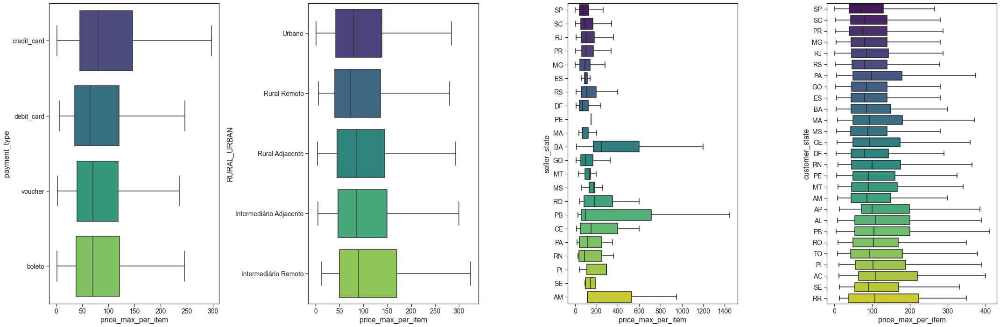

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='price_mean_item', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_mean_item', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_mean_item', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_mean_item', ylabel='customer_state'>

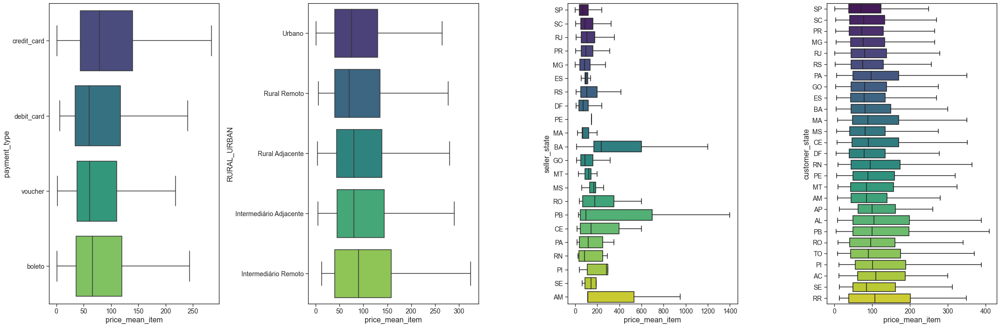

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='price_min_per_item', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_min_per_item', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_min_per_item', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='price_min_per_item', ylabel='customer_state'>

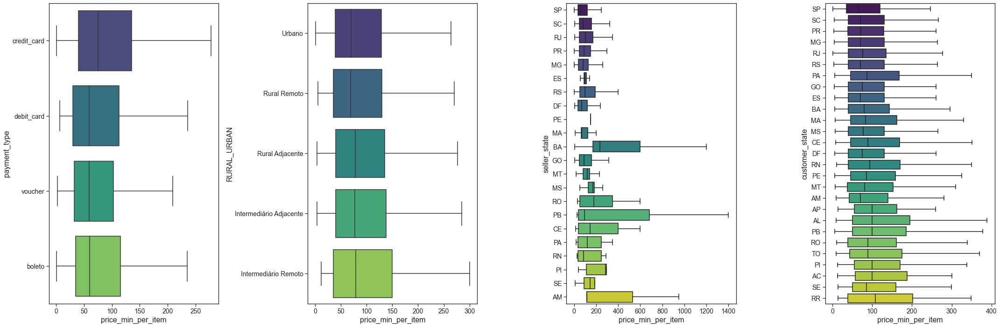

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_sequential', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_sequential', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_sequential', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_sequential', ylabel='customer_state'>

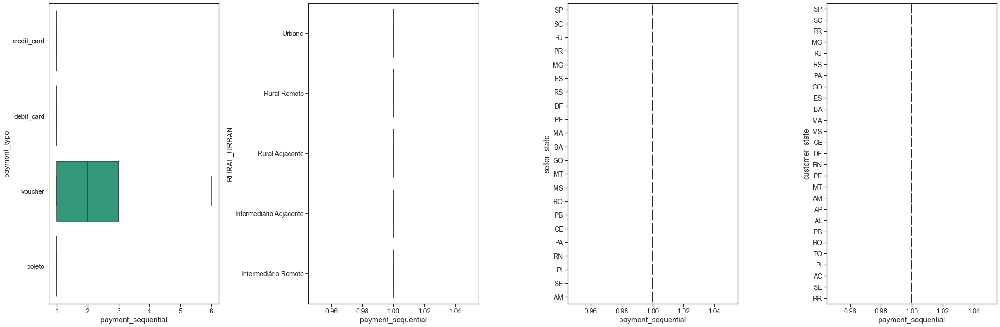

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_installments', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_installments', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_installments', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_installments', ylabel='customer_state'>

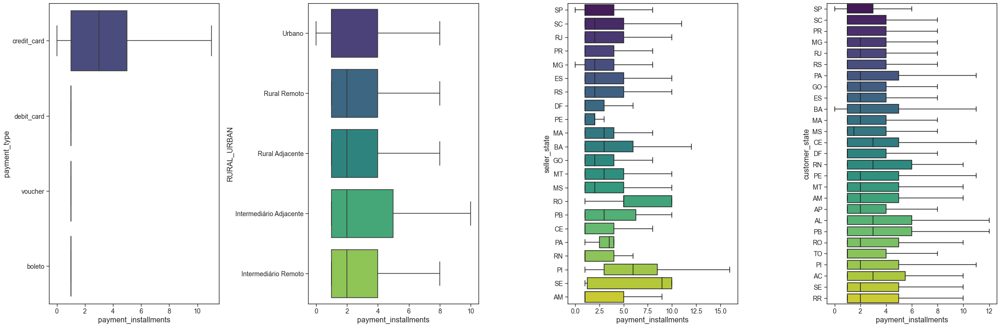

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_value', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_value', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_value', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='payment_value', ylabel='customer_state'>

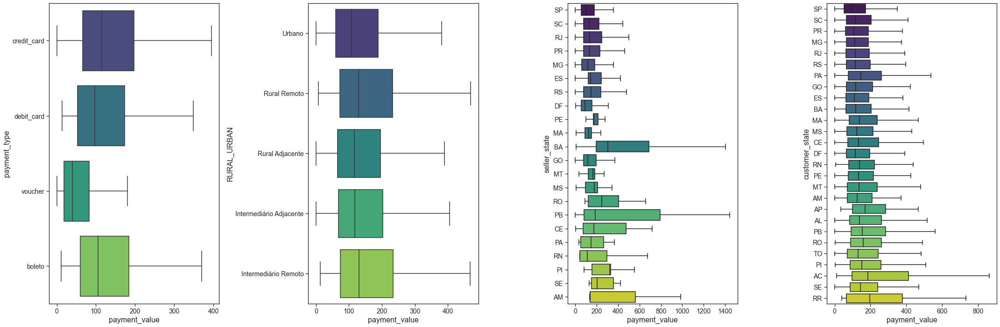

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='t_purchase_delivery', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_purchase_delivery', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_purchase_delivery', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_purchase_delivery', ylabel='customer_state'>

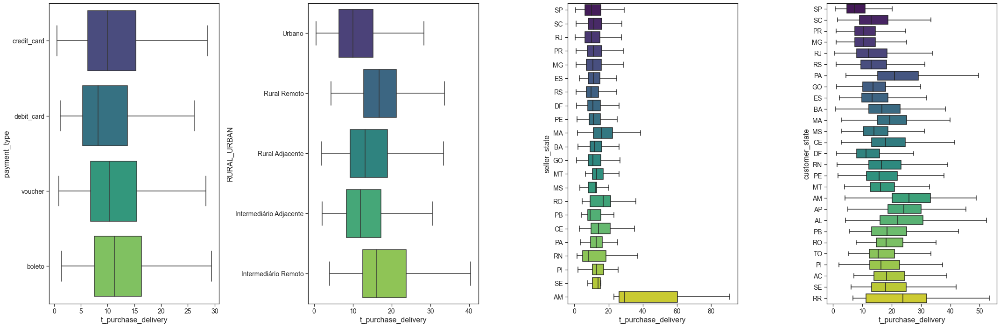

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='t_expected_delivery', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_expected_delivery', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_expected_delivery', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_expected_delivery', ylabel='customer_state'>

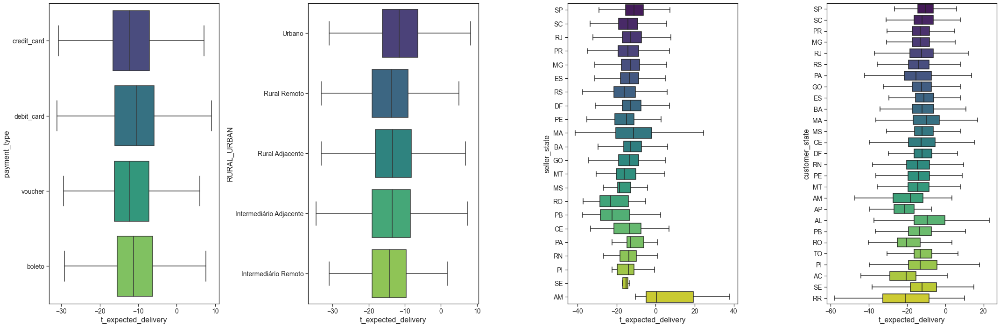

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='t_delivery_review', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_delivery_review', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_delivery_review', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_delivery_review', ylabel='customer_state'>

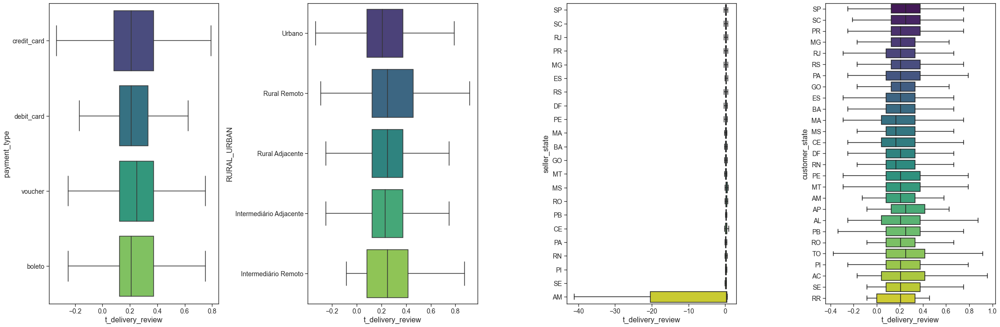

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='t_answer_review', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_answer_review', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_answer_review', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='t_answer_review', ylabel='customer_state'>

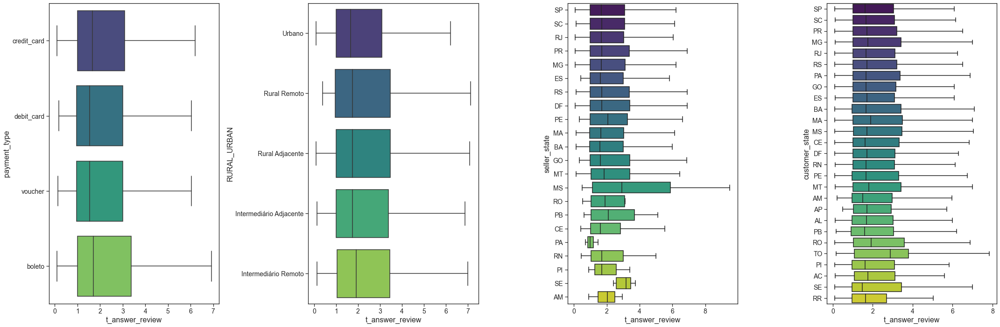

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='review_score', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='review_score', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='review_score', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='review_score', ylabel='customer_state'>

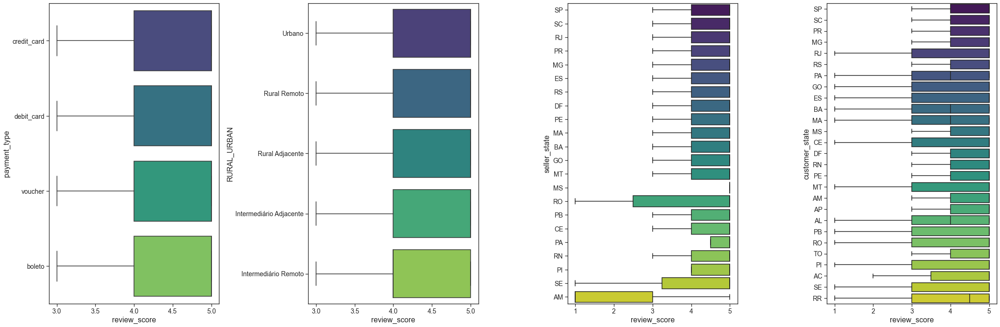

<Figure size 2160x720 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='review_length', ylabel='payment_type'>

<AxesSubplot:>

<AxesSubplot:xlabel='review_length', ylabel='RURAL_URBAN'>

<AxesSubplot:>

<AxesSubplot:xlabel='review_length', ylabel='seller_state'>

<AxesSubplot:>

<AxesSubplot:xlabel='review_length', ylabel='customer_state'>

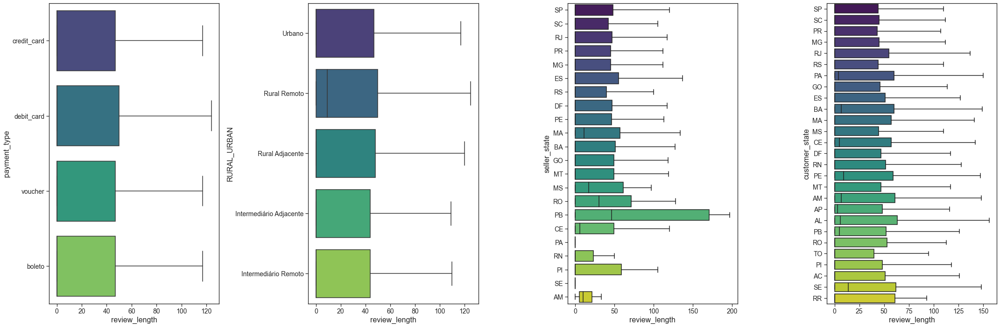

In [741]:
for col in num_col:
    plt.figure(figsize=(30, 10))
    for i in range(len(cat_col2[:-1])):
        plt.subplot(1, len(cat_col2[:-1]), i+1)
        sns.boxplot(data=df3,
                    x=col,
                    y=cat_col2[i],
                    orient="h",
                    showfliers=False,
                    palette="viridis")
    plt.tight_layout(pad=1)
    plt.show()

## Multivariate analysis: cat/num/num

In [710]:
num_col

Index(['customer_zip_code_prefix', 'cust_city_population', 'GDP_CAPITA',
       'POST_OFFICES', 'seller_zip_code_prefix', 'weekday_purchase',
       'distance', 'n_order', 'mean_item_per_order', 'product_volume', 'price',
       'price_max_per_item', 'price_mean_item', 'price_min_per_item',
       'payment_sequential', 'payment_installments', 'payment_value',
       't_purchase_delivery', 't_expected_delivery', 't_delivery_review',
       't_answer_review', 'review_score', 'review_length'],
      dtype='object')

Index(['price_min_per_item', 'payment_sequential', 'payment_installments',
       'payment_value', 't_purchase_delivery', 't_expected_delivery',
       't_delivery_review', 't_answer_review', 'review_score',
       'review_length'],
      dtype='object')

In [731]:
corr = [[], [], [], [], []]

for col1 in num_col[1:]:
    print(col1)
    for col11 in num_col[1:]:
        for col2 in cat_col2:
            for string in df3[col2].unique():
                if (np.abs(df3[df3[col2] == string] \
                [[col1, col11]].corr().iloc[0, 1]) > 0.50) \
                and (col1 != col11) and (len(df3[df3[col2] == string] \
                [[col1, col11]]) > 1000) and (np.abs(df3 \
                [[col1, col11]].corr().iloc[0, 1]) < 0.50):
                    print(col1,col11,col2)
                    corr[0].append(col1)
                    corr[1].append(col11)
                    corr[2].append(col2)
                    corr[3].append(string)
                    corr[4].append(df3[df3[col2] == string]
                                   [[col1, col11]].corr().iloc[0, 1]
                                  )

cust_city_population
cust_city_population GDP_CAPITA customer_state
cust_city_population GDP_CAPITA customer_state
GDP_CAPITA
GDP_CAPITA cust_city_population customer_state
GDP_CAPITA cust_city_population customer_state
GDP_CAPITA POST_OFFICES customer_state
GDP_CAPITA POST_OFFICES customer_state
GDP_CAPITA POST_OFFICES customer_state
POST_OFFICES
POST_OFFICES GDP_CAPITA customer_state
POST_OFFICES GDP_CAPITA customer_state
POST_OFFICES GDP_CAPITA customer_state
seller_zip_code_prefix
seller_zip_code_prefix distance customer_state
seller_zip_code_prefix distance customer_state
seller_zip_code_prefix distance customer_state
seller_zip_code_prefix distance customer_state
weekday_purchase
distance
distance seller_zip_code_prefix customer_state
distance seller_zip_code_prefix customer_state
distance seller_zip_code_prefix customer_state
distance seller_zip_code_prefix customer_state
n_order
mean_item_per_order
mean_item_per_order payment_value customer_state
mean_item_per_order t_delivery_

In [732]:
df_corr = pd.DataFrame(corr).T

In [733]:
df_corr

,0,1,2,3,4
0,cust_city_population,GDP_CAPITA,customer_state,RJ,0.588119
1,cust_city_population,GDP_CAPITA,customer_state,DF,0.999449
2,GDP_CAPITA,cust_city_population,customer_state,RJ,0.588119
3,GDP_CAPITA,cust_city_population,customer_state,DF,0.999449
4,GDP_CAPITA,POST_OFFICES,customer_state,RJ,0.612902
5,GDP_CAPITA,POST_OFFICES,customer_state,ES,0.581955
6,GDP_CAPITA,POST_OFFICES,customer_state,DF,0.999599
7,POST_OFFICES,GDP_CAPITA,customer_state,RJ,0.612902
8,POST_OFFICES,GDP_CAPITA,customer_state,ES,0.581955
9,POST_OFFICES,GDP_CAPITA,customer_state,DF,0.999599


t_delivery_review 	mean_item_per_order 	product_category_name_english 	perfumery 	0.513299

In [734]:
corr = [[], []]

for string in df3["product_category_name_english"].unique():
    corr[0].append(string)
    corr[1].append(df3[df3[col2] == string][["mean_item_per_order", "t_delivery_review"]].corr().iloc[0, 1]
              )

In [768]:
pd.DataFrame(corr).T.head(30)
pd.DataFrame(corr).T.tail(30)

,0,1
41,industry_commerce_and_business,0.088017
42,fashion_underwear_beach,0.049891
43,dvds_blu_ray,0.098592
44,construction_tools_safety,0.016379
45,food,0.044112
46,fixed_telephony,0.050226
47,furniture_living_room,0.002945
48,tablets_printing_image,-0.018948
49,market_place,0.044211
50,agro_industry_and_commerce,0.024036


# Bonus

In [815]:
import plotly.express as px

fig = px.scatter_mapbox(df2,
                        lat="geolocation_lat_customer",
                        lon="geolocation_lng_customer",
                        color=df2["price"].fillna(0),
                        size=df2["price"].fillna(0),
                        zoom=1.5,
                        height=500,
                        color_continuous_scale="viridis",
                        )

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()